# Project 1 Data Exploration and Analysis
#### 5/24/2020
#### Yang Zhang, Reannan McDaniel, Jonathon Roach, Fred Poon

[Github Repo](https://github.com/fredpoon/ds_7331_jyrf_eda)

In [78]:
# required libraries for this notebook
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

## Business Understanding
For this analysis, our group will be working with North Carolina Public Schools Report Card and Statistical Profiles Data sets from the years 2014 to 2017. These data sets encompass information across 4 continuous years of educational attributes in North Carolina, USA.  The data is collected from the State of North Carolina at [http://ncpublicschools.org](http://ncpublicschools.org) and made available from the Belk Endowment Educational Attainment Data Repository for North Carolina Public Schools by Dr. Jake Drew. Among other reasons, the data was collected for evaluation of public-school performance for the purpose of efficiently allocating funds to various educational initiatives. Analyses of such data are important because high-impact educational initiatives that are well-funded contribute to increased graduation rates, increased achievement at the post-secondary level, less crime, and greater economic engagement among young people. For the purpose of this exercise, our focus is on describing and predicting school performance using various school characteristics, such as type of school (elementary, middle, high, or some combination of the three), social demographics, economic demographics, and location between 2014 and 2017. The Belk Foundation's website says, "Our goal is to empower today’s workforce by creating pathways to and through postsecondary education for underrepresented students". For the sake of this analysis, we assume that better performing schools have better outcomes in postsecondary education. With North Carolina's rapidly changing demographics, it is important to take into consideration schools' unique needs when allocating funds to strategic investment initiatives. Here, we explore where funding can be best applied based on educational achievement data.

To achieve this goal, we will explore through visual and mathematical modeling which features best predict the School Performance Grade (SPG Score), a continuous measure of a school's overall success based on test scores and growth measures. The analysis will come in the form of a regression model, and accuracy of the model will be determined by the root mean-squared error (RMSE). Predicting SPG within 15 points could be beneficial to an organization, like Belk Endowment, to efficiently allocate funds to schools.

## Data Understanding
### Data Meaning Type

The data set contains 9,731 records and 259 attributes that are comprised of factors, numbers, and characters. A data definition sheet can be found in Dr. Drew's github repository, [https://github.com/jakemdrew/EducationDataNC](https://github.com/jakemdrew/EducationDataNC/tree/master/Data%20Documentation). To scale the data to be more manageable, our data set includes 11 of the 259 attributes. 

These variables were chosen after initial EDA and correlation visuals were generated between SPG and all predictors. The data type, category and description are displayed in the following table.

### Attributes
| Attribute | DataType | Description |
|:---|:---|:---|
| SPG Score | float64 | School Performance Grade (number, 0-100) |
| SPG Grade | object | School Performance Grade (Letter Grade - A-D, F) |
| avg_daily_attend_pct | float64 | Average daily attendance percentage (0.8-1.0) |
| category_cd | object | Category Code of the school level E=Elementary, M=Middle, H=High School, I=Elem/Mid Combo, A=All Schools |
| category_cd_modified | object | New Feature - simplified category_cd to distinguish between school types vs combined school levels |
| crime_per_c_num | float64 | Number of crimes or acts of violence per 100 students at the school level (0-13) |
| Majority_Minority | object | New Feature - classifying schools as having majority student body from minority racial groups (0 = Majority of non minority, 1 = Majority of minority |
| MinorityFemalePct | float64 | Percentage of female minorities at the school level (0-100) |
| MinorityMalePct | float64 | Percentage of male minorities at the school (0-100) |
| MinorityOverallPct | float64 | New Feature - Minority Overall Percentage (0-100) |
| school_type_txt | object | Description of school type (Regular School, Magnet School, etc.) |
| short_susp_per_c_num | float64 | Short term suspensions per 100 students at the school level (0-181) |
| student_num | float64 | School size or number of students at the school level (8-2966) |
| tchyrs_0thru3_pct | float64 | Percentage of teachers with 0-3 years of teaching experience (0.0-1.0) |
| Year | int64 | New Feature - School Year (2014-2017) |

In [85]:
# Reproducibility, we're providing github URL to CSV file as well
# https://github.com/fredpoon/ds_7331_jyrf_eda/blob/master/PublicSchools2014to2017_YZ.csv
schools = pd.read_csv('PublicSchools2014to2017_YZ.csv')

# schools.head()
schools[['SPG Score','SPG Grade','avg_daily_attend_pct','category_cd',
         'crime_per_c_num','EVAAS Growth Status','lea_federal_perpupil_num',
         'MinorityFemalePct','MinorityMalePct','Proficient_TCHR_Standard 1_Pct',
         'school_type_txt','Science Score','short_susp_per_c_num','student_num',
         'tchyrs_0thru3_pct','Year']].head()

,SPG Score,SPG Grade,avg_daily_attend_pct,category_cd,crime_per_c_num,EVAAS Growth Status,lea_federal_perpupil_num,MinorityFemalePct,MinorityMalePct,Proficient_TCHR_Standard 1_Pct,school_type_txt,Science Score,short_susp_per_c_num,student_num,tchyrs_0thru3_pct,Year
0,85.0,A,0.872,H,0.00,0,1006.4,0.243243,0.067568,0.200,Regular School,0.0,4.11,78.0,0.000,2014
1,67.0,C,0.957,E,0.38,Exceeded,1006.4,0.157699,0.163265,0.300,Regular School,73.0,0.94,539.0,0.206,2014
2,67.0,C,0.954,E,0.17,Met,1006.4,0.094096,0.107011,0.194,Regular School,65.0,0.35,547.0,0.057,2014
3,36.0,F,0.943,M,1.75,NotMet,1006.4,0.445980,0.463568,0.207,Regular School,41.0,32.66,800.0,0.269,2014
4,74.0,B,0.944,E,0.00,Exceeded,1006.4,0.164134,0.173252,0.233,Regular School,76.0,2.10,664.0,0.310,2014


In [53]:
# schools.info()
schools[['SPG Score','SPG Grade','avg_daily_attend_pct','category_cd','crime_per_c_num',
         'EVAAS Growth Status','lea_federal_perpupil_num','MinorityFemalePct','MinorityMalePct',
         'Proficient_TCHR_Standard 1_Pct','school_type_txt','Science Score','short_susp_per_c_num',
         'student_num','tchyrs_0thru3_pct','Year']].info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9731 entries, 0 to 9730
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   SPG Score                       9731 non-null   float64
 1   SPG Grade                       9731 non-null   object 
 2   avg_daily_attend_pct            9731 non-null   float64
 3   category_cd                     9731 non-null   object 
 4   crime_per_c_num                 9731 non-null   float64
 5   EVAAS Growth Status             9731 non-null   object 
 6   lea_federal_perpupil_num        9731 non-null   float64
 7   MinorityFemalePct               9731 non-null   float64
 8   MinorityMalePct                 9731 non-null   float64
 9   Proficient_TCHR_Standard 1_Pct  9731 non-null   float64
 10  school_type_txt                 9731 non-null   object 
 11  Science Score                   9731 non-null   float64
 12  short_susp_per_c_num            97

### Data Quality
#### Summary
As mentioned above, the established data files (from 2014 to 2019) provided by Dr. Drew processed from raw data*. Further data wrangling efforts are conducted to (1) make the data files more reproducible for use with machine learning modeling and (2) combine the data files based on calendar years together so we can find trends. We will go into more detail below.

In process (1) we will tackle data wrangling. We refer to Dr. Drew’s data cleaning scripts** including multiple impute and cleaning process. During exploratory data analysis, we manipulated categorical variables to remove outliers. We re-mapped the categorical variable, category_cd, so it could be reproducible. We also filtered the data on school_type_txt which showed an overwhelming favor to Regular Schools. We that, we separated a new data frame just to Regular Schools. The final significant data manipulation is to SPG Score. We filtered out 0’s as it does not make sense to train a model with data that is missing a response variable.

For our process (2) we merged all year-based data files together between 2014 and 2017. Because discrepancies in data 2018/2019, including incomplete data, an inner join process is conducted and the resulted combined dataset that totaled 259 attributes and 9731 rows.

#### References
*[http://nbviewer.jupyter.org/github/jakemdrew/EducationDataNC/blob/master/2014/School%20Datasets/PublicSchools2014.csv]( http://nbviewer.jupyter.org/github/jakemdrew/EducationDataNC/blob/master/2014/School%20Datasets/PublicSchools2014.csv)
**[https://nbviewer.jupyter.org/github/jakemdrew/EducationDataNC/tree/master/2014/Machine%20Learning%20Datasets/Source%20Code/PublicSchools2014_ML.ipynb](https://nbviewer.jupyter.org/github/jakemdrew/EducationDataNC/tree/master/2014/Machine%20Learning%20Datasets/Source%20Code/PublicSchools2014_ML.ipynb)

#### Data Wrangling

It is important to understand the types of schools that are relevant to this analysis. Let's first take a look at school type and see if there are any anomolies (schools for children with disabilities, for example).

In [54]:
pd.DataFrame(schools.school_type_txt.value_counts())

,school_type_txt
Regular School,8810
Magnet School,527
Alternative Education,291
Special Education,82
Hospital School,14
0,6
Vocational Education,1


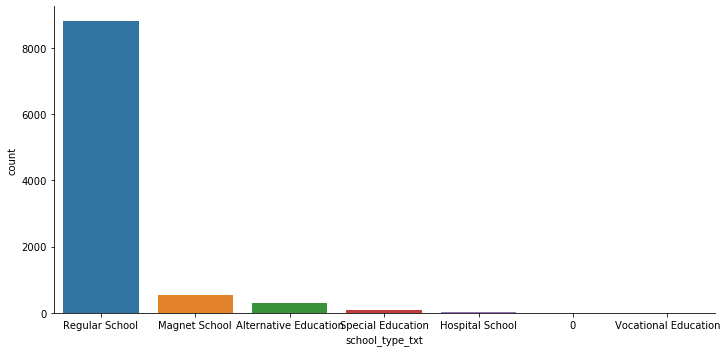

In [79]:
#Distribution of School Category
sns.factorplot("school_type_txt", data=schools, aspect=2,
                       kind="count",order = schools['school_type_txt'].value_counts().index)
plt.show()

In [56]:
# Data Frame of school type and counts
pd.DataFrame(schools["school_type_txt"].value_counts())

,school_type_txt
Regular School,8810
Magnet School,527
Alternative Education,291
Special Education,82
Hospital School,14
0,6
Vocational Education,1


In [57]:
# A second dataframe to hold just Regular Schools
schools2 = schools[schools["school_type_txt"] == 'Regular School']
pd.DataFrame(schools2["school_type_txt"].unique())

,0
0,Regular School


According to the table and chart above, the dataset is mostly composed Regulars Schools. We created a new dataframe to hold just this set to run our models on.

Let's now take a look at schools by the age ranges of their students: elementary, middle, high, and various combinations of the three.

In [80]:
schools2['category_cd'] == 'E'
# schools2['category_cd'].unique()
schools2['category_cd_modified'] = np.select(
    [
        schools2['category_cd'] == 'A', 
        schools2['category_cd'] == 'E',
        schools2['category_cd'] == 'H',
        schools2['category_cd'] == 'I',
        schools2['category_cd'] == 'M'
    ], 
    [
        'Elem./Mid./High Together', 
        'Elementary School',
        'High School',
        'Elem./Mid. Together',
        'Middle School'
    ],
    default='Mid./High Together'
)

pd.DataFrame(schools2.category_cd_modified.value_counts())

,category_cd_modified
Elementary School,4848
High School,1826
Middle School,1771
Elem./Mid. Together,287
Mid./High Together,55
Elem./Mid./High Together,23


Some of these categories have very little representation in the data. For now, we'll remedy this by lumping the combo groups together.

In [10]:
combo = schools2['category_cd_modified'].str.contains('/', regex=False)

schools2['category_cd_modified'] = np.where(combo, 'Combo', schools2['category_cd_modified'])

pd.DataFrame(schools2.category_cd_modified.value_counts())

,category_cd_modified
Elementary School,4848
High School,1826
Middle School,1771
Combo,365


We now need to somehow get at the idea of demographic composition of schools. Dr. Drew and his capstone groups have shown that classifying schools as majority-minority when they are composed of >50% non-white students highlights meaningful differences in school performance (likely due to the fact that demographics can serve as a stand-in for economic measures). Let's take the same approach.

In [11]:
schools2['MinorityOverallPct'] = schools2['MinorityMalePct'] + schools2['MinorityFemalePct']

schools2['Majority_Minority'] = np.where(schools2['MinorityOverallPct'] > .5, 1,0)

pd.DataFrame(schools2['Majority_Minority'].value_counts())

,Majority_Minority
0,4833
1,3977


In [12]:
# Lets clean up the data to better visualize SPG
SPG = schools2[schools2['SPG Score']!=0]

As we continue our visualizations below, let's clean up SPG Score by excluding 0 values. We will store this in the dataframe SPG.

### Simple Statistics
<!-- [10] Visualize appropriate statistics (e.g., range, mode, mean, median, variance, counts) for a subset of attributes. Describe anything meaningful you found from this or if you found something potentially interesting. Note: You can also use data from other sources for comparison. Explain why the statistics run are meaningful. -->

Here's some summary statistics of the immediate attributes we'll be using for visuals. As we can see, we have a min value of 0 for SPG Score. As stated above, it is unhelpful to train a model on response variables that are effectively missing. 

Despite cleaning the dataset, we still have values of 0 in several of our continuous variables. We will not run imputation to fill these in because values of 0 makes sense in context (for instance, it's completely plausible that certain schools have 0% teachers with 0-3 years of experience).


In [83]:
schools2[['SPG Score','avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct', 'crime_per_c_num',
          'short_susp_per_c_num', 'MinorityFemalePct', 'MinorityMalePct']].describe()

,SPG Score,avg_daily_attend_pct,student_num,tchyrs_0thru3_pct,crime_per_c_num,short_susp_per_c_num,MinorityFemalePct,MinorityMalePct
count,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000,8810.000000
mean,62.166288,0.952950,604.964813,0.220468,0.527553,12.946733,0.239958,0.246351
std,15.423596,0.017202,367.486455,0.117472,0.761857,16.723613,0.133608,0.140209
min,0.000000,0.803000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,54.000000,0.945000,368.000000,0.138000,0.000000,2.430000,0.127723,0.127784
50%,63.000000,0.953000,532.000000,0.206000,0.230000,7.120000,0.224177,0.227841
75%,72.000000,0.960000,741.000000,0.286000,0.780000,16.730000,0.343349,0.352619
max,100.000000,1.000000,2966.000000,1.000000,12.260000,181.520000,0.990476,0.991071


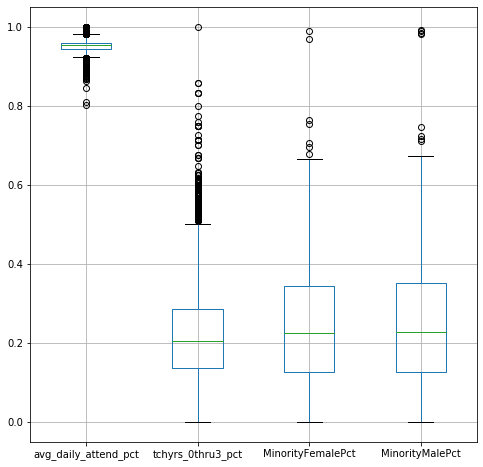

In [44]:
# visualize summary statistics on attributes
schools2.boxplot(column=['avg_daily_attend_pct','tchyrs_0thru3_pct', 
                         'MinorityFemalePct','MinorityMalePct'], figsize=(8,8))

plt.show()

None of the boxplots above reveal anything too shocking. Some of the extreme values are interesting, though. For instance, there are schools with average attendance as low as 80%, and rate of inexperienced teachers as high as 100%. It will be interesting to later observe the relationships between these variables and SPG score.

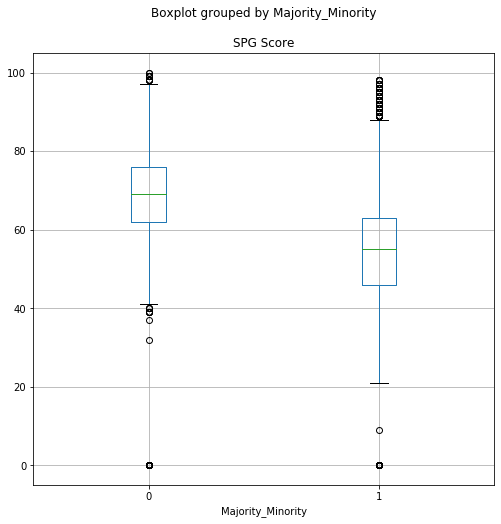

In [15]:
# Here we will run a boxplot to show SPG Score by Majority_Minority
schools2.boxplot(column='SPG Score', by='Majority_Minority', figsize=(8,8))
plt.show()

In [16]:
schools2.groupby('Majority_Minority')[['SPG Score']].median()

,SPG Score
Majority_Minority,
0,69.0
1,55.0


For schools where majority student body is of minority race, the median SPG Score is around 55 versus an SPG score of 69 for majority student body is of majority race.

### Visualize Attributes
<!-- [15] Visualize the most interesting attributes (at least 5 attributes, your opinion on what is interesting). Important: Interpret the implications for each visualization. Explain for each attribute why the chosen visualization is appropriate. -->

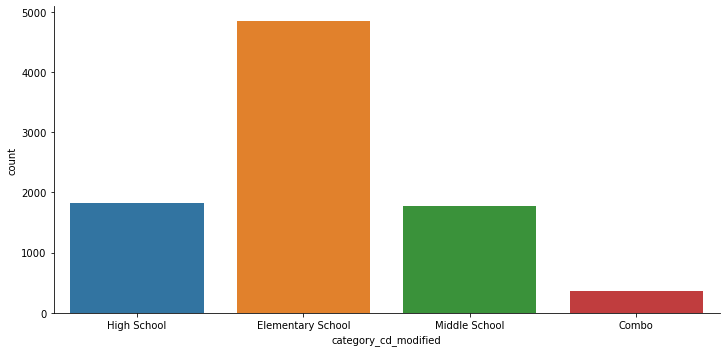

In [17]:
#Distribution of School Category
sns.factorplot("category_cd_modified", data=schools2, aspect=2,
                       kind="count")
plt.show()

In our data wrangling process, we re-mapped category_cd to create category_cd_modified. This captures school types for reproducibility. In the chart above, we see Elementary Schools make up the majority of schools within our dataset. This makes sense as the Elementary Schools feed into Middles Schools and ultimately feeds into High Schools.

#### Visualizing SPG

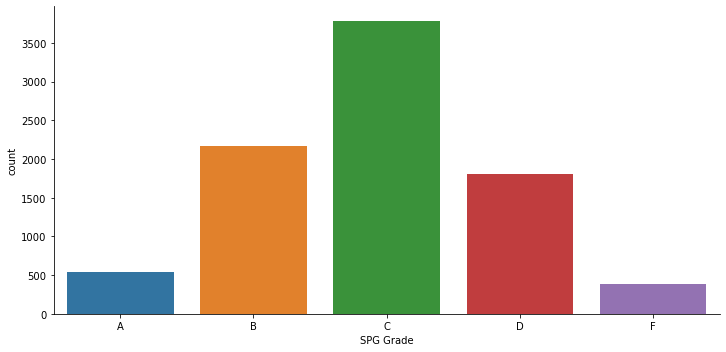

In [43]:
remap_cat_dict = {
    'C': 'C',
    'B': 'B',
    'D': 'D',
    'F': 'F',
    'A': 'A',
    'A+NG': 'A'}

SPG["SPG Grade"] = SPG["SPG Grade"].map(remap_cat_dict).astype('category')

# pd.DataFrame(SPG["SPG Grade"].value_counts())
sns.factorplot("SPG Grade", data=SPG, aspect=2,
                       kind="count", order=['A','B','C','D','F'])

plt.show()

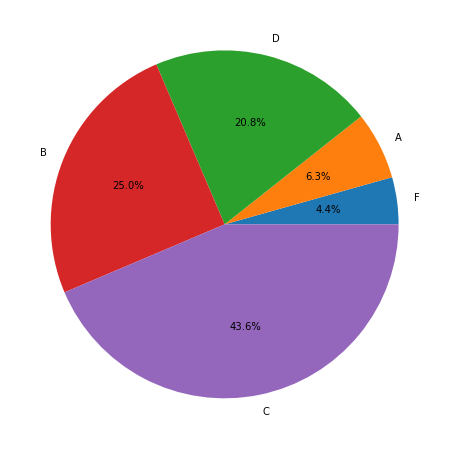

In [38]:
#Pie Plot of SPG Grade Distribution
pie_SPG = SPG.groupby('SPG Grade').agg('count')

plt.figure(1, figsize=(8,8))

SPG_labels = pie_SPG.school_type_txt.sort_values().index
SPG_counts = pie_SPG.school_type_txt.sort_values()

plt.pie(SPG_counts, labels=SPG_labels, autopct='%1.1f%%')

plt.show()

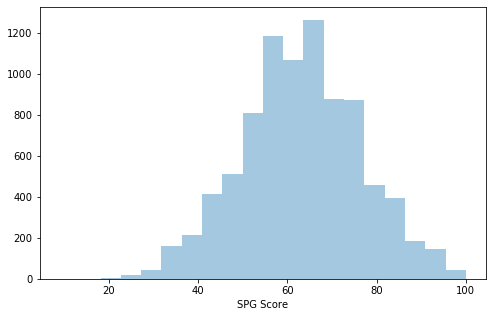

In [61]:
f, ax = plt.subplots(figsize=(8, 5))
sns.distplot(SPG["SPG Score"], bins=20, kde=False,ax=ax)
plt.show()

Interestingly, the distribution of SPG grades is approximately normal, with the median score awarded being a "C". This indicates that we're not working with a ranking system that is biased to be particularly lenient or harsh on schools. 

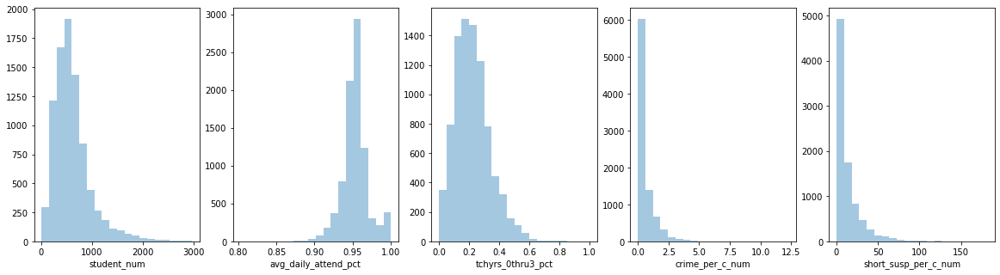

In [76]:
f, ax = plt.subplots(1,5,figsize=(20, 5))
sns.distplot(SPG["student_num"], bins=20, kde=False, ax=ax[0])
sns.distplot(SPG["avg_daily_attend_pct"], bins=20, kde=False, ax=ax[1])
sns.distplot(SPG["tchyrs_0thru3_pct"], bins=20, kde=False, ax=ax[2])
sns.distplot(SPG["crime_per_c_num"], bins=20, kde=False, ax=ax[3])
sns.distplot(SPG["short_susp_per_c_num"], bins=20, kde=False, ax=ax[4])
plt.show()

Here are histogram plots to show distribution of our continuous variables. As we can see, there is strong right skew on student body size, teacher 0-3yr experience, crime per 100 students, and short suspension per 100 students while average daily attendance percentage showed left skew.

### Explore Joint Attributes
<!-- [15] Visualize relationships between attributes: Look at the attributes via scatter plots, correlation, cross-tabulation, group-wise averages, etc. as appropriate. Explain any interesting relationships. -->

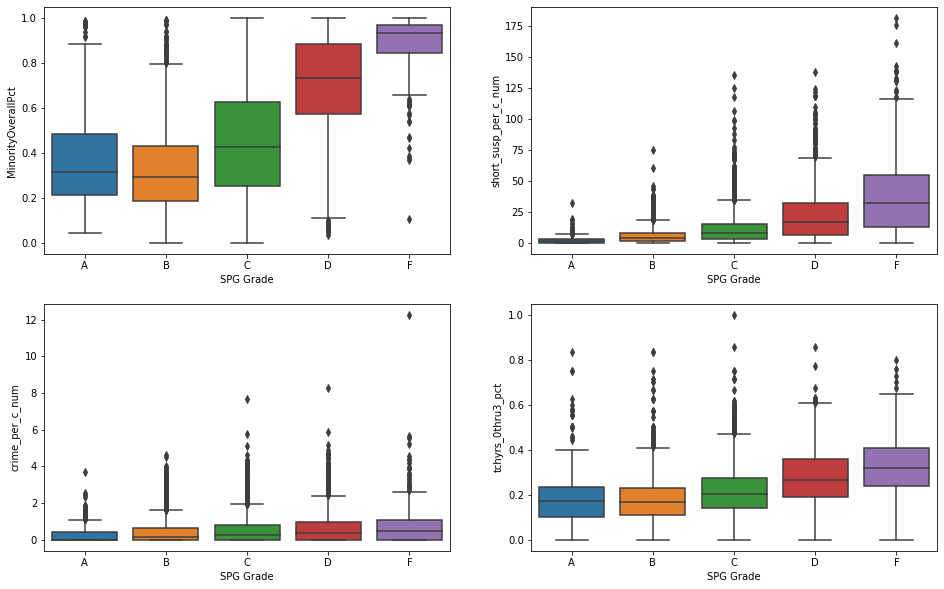

In [37]:
#Let's see the distribution of scores with different variables
f, axes = plt.subplots(2, 2,figsize=(16,10))

#SPG grade related to white percentage
sns.boxplot(  y="MinorityOverallPct", x= "SPG Grade", data=SPG,  orient='v',
            ax=axes[0,0],order=['A','B','C','D','F'])

#SPG grade related to Short term suspensions per 100 students
sns.boxplot(  y="short_susp_per_c_num", x= "SPG Grade", data=SPG,  orient='v', 
            ax=axes[0,1],order=['A','B','C','D','F'])

#SPG grade related to Crime rate
sns.boxplot(  y="crime_per_c_num", x= "SPG Grade", data=SPG,  orient='v', 
            ax=axes[1,0],order=['A','B','C','D','F'])

#SPG grade related to teacher experience
sns.boxplot(  y="tchyrs_0thru3_pct", x= "SPG Grade", data=SPG,  orient='v', 
            ax=axes[1,1],order=['A','B','C','D','F'])

plt.show()

__A general observation:__

- The lower the grade, the higher the minority overall percentage.
- The lower the grade, the higher the short term suspensions rate.
- The lower the grade, the higher the crime rate.
- The lower the grade, the higher the percentage of teacher with 0 to 3 years of experience.

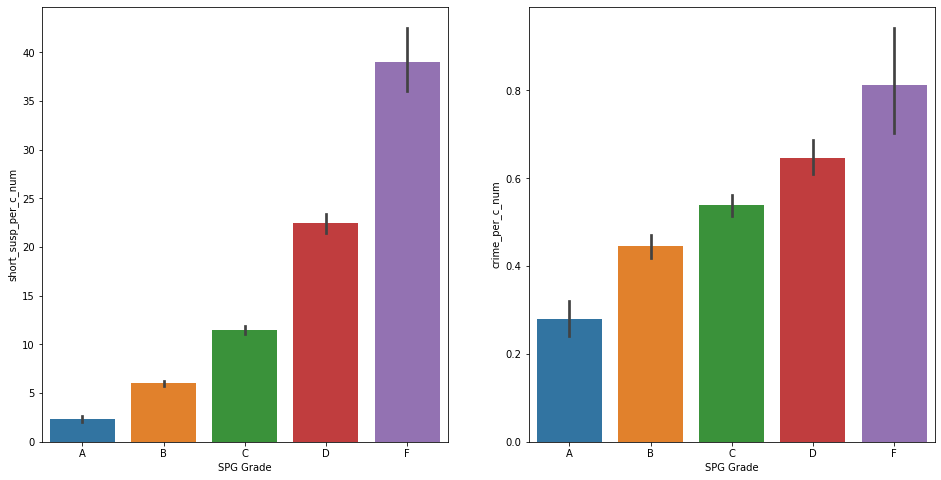

In [34]:
#Let's see the bar plots of scores with different variables
fig, axarr  = plt.subplots(1,2,figsize=(16,8))
sns.barplot(x='SPG Grade', y='short_susp_per_c_num', data=SPG,
            order=['A','B','C','D','F'], ax=axarr[0])
sns.barplot(x='SPG Grade', y='crime_per_c_num', data=SPG,
            order=['A','B','C','D','F'], ax=axarr[1])

plt.show()

It seems as though there are similarities between these categories. We see higher average values in the 'F' score range in the short term suspension and crime per 100 students categories. This might be an indication that crime and short-term suspensions are in some way related. It might also hint that short-term suspensions are an ineffective way to increase overall school performance.

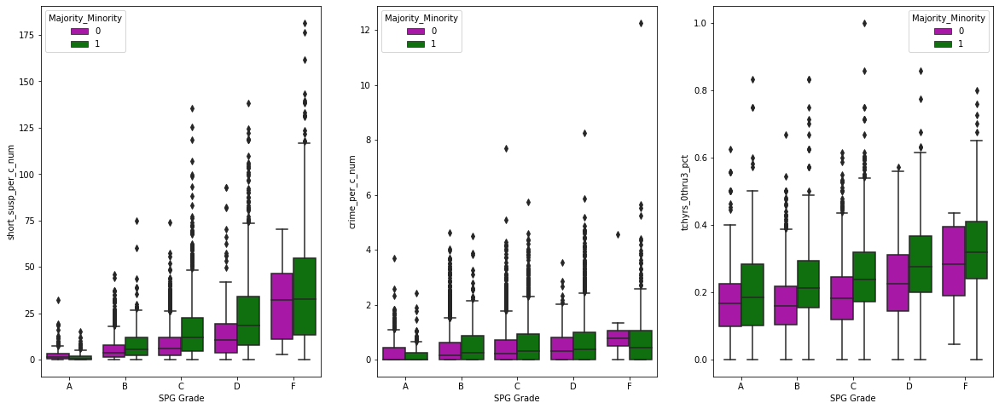

In [33]:
#Comparison of multiple variables with less or more minorities in school
f, axes = plt.subplots(1, 3,figsize=(20,8))

sns.boxplot(x= "SPG Grade", y="short_susp_per_c_num",
            hue="Majority_Minority", palette=["m", "g"],
            data=SPG, ax=axes[0], order=['A','B','C','D','F'])

sns.boxplot(x= "SPG Grade", y="crime_per_c_num",
            hue="Majority_Minority", palette=["m", "g"],
            data=SPG, ax=axes[1], order=['A','B','C','D','F'])

sns.boxplot(x= "SPG Grade", y="tchyrs_0thru3_pct",
            hue="Majority_Minority", palette=["m", "g"],
            data=SPG, ax=axes[2], order=['A','B','C','D','F'])

plt.show()

__A general observation:__

- The lower the grade, the larger variation the short term suspensions rate. No obvious difference between school groups.
- The lower the grade, the larger variation the crime rate.
- Slightly higher the percentage of teacher with 0 to 3 years of experience for minority schools

In [23]:
# the cross tab operator provides an easy way to get these numbers
spg_ct = pd.crosstab([ SPG['school_type_txt'],SPG['Majority_Minority'] ], 
                       SPG['SPG Grade'].astype('category'))
print(spg_ct)

SPG Grade                            A     B     C     D    F
school_type_txt Majority_Minority                            
Regular School  0                  423  1802  2234   297    7
                1                  122   364  1549  1505  372


Observation: The proportion between Majority and Minority Schools on Grade A-F is apparently different.

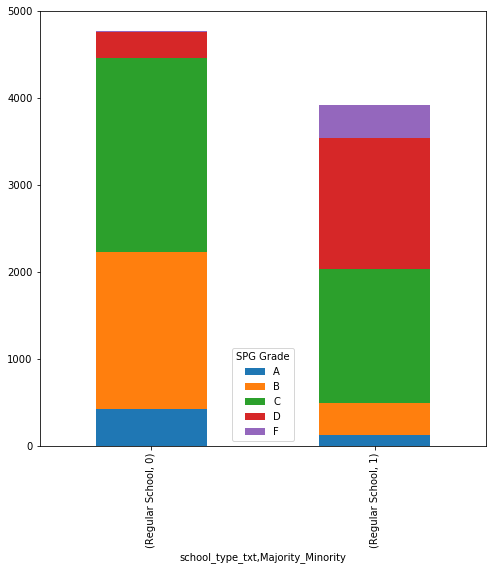

In [36]:
spg_ct.plot(kind='bar', stacked=True, figsize=(8,8))

plt.show()

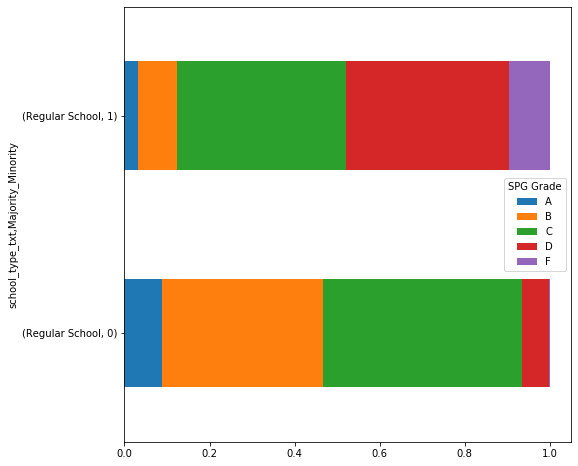

In [35]:
# normalize the value
spg_rate = spg_ct.div(spg_ct.sum(1).astype(float), axis=0)

spg_rate.plot(kind='barh', stacked=True, figsize=(8,8))
plt.show()

From the stacked bar chart above, we can see that in Regular Schools, majority of non minority (Majority_Minority = 0) race has a grade of B and C. And Regulars Schools where majority of minority (Majority_Minority = 1) race has a grade of C and D.

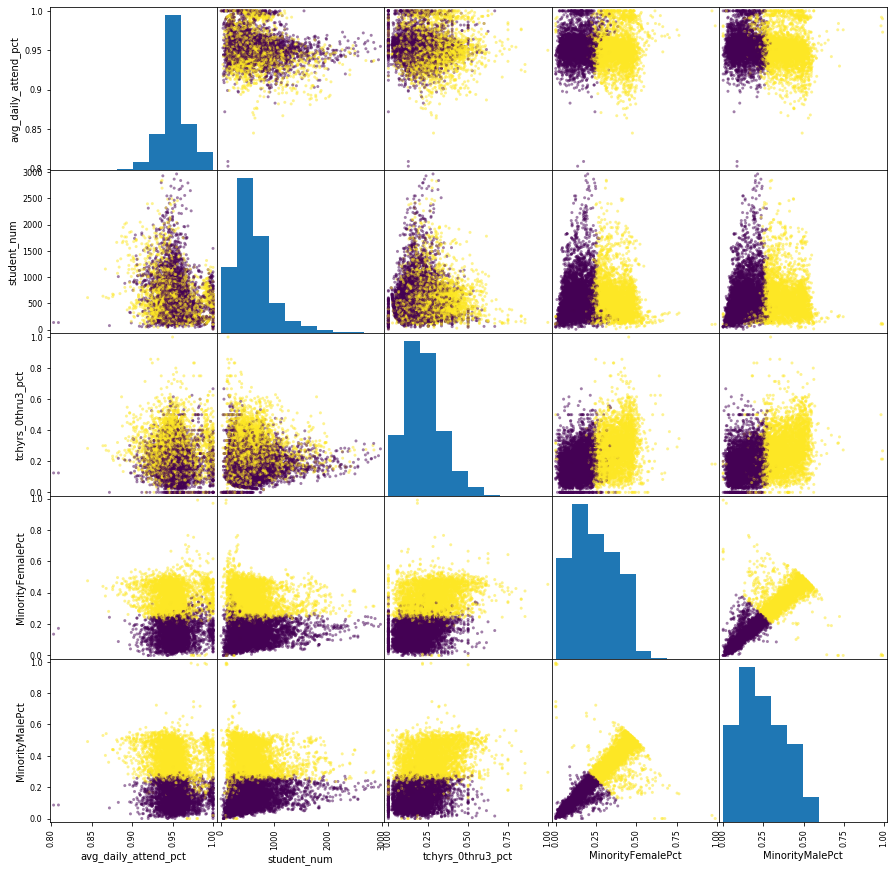

In [26]:
# create a new dataframe 
schools3 = schools2[['avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct',
                     'MinorityFemalePct','MinorityMalePct', 'Majority_Minority']]

pd.plotting.scatter_matrix(schools3[['avg_daily_attend_pct', 'student_num',
                                     'tchyrs_0thru3_pct', 'MinorityFemalePct',
                                     'MinorityMalePct']], c=schools3['Majority_Minority'],
                           figsize=(15,15))

plt.show()

Here's a scatterplot matrix of continuous variables colored by Majority_Minority. Here we can see collinearity between student body size and teacher experience. Examples such as this could be useful for modeling.

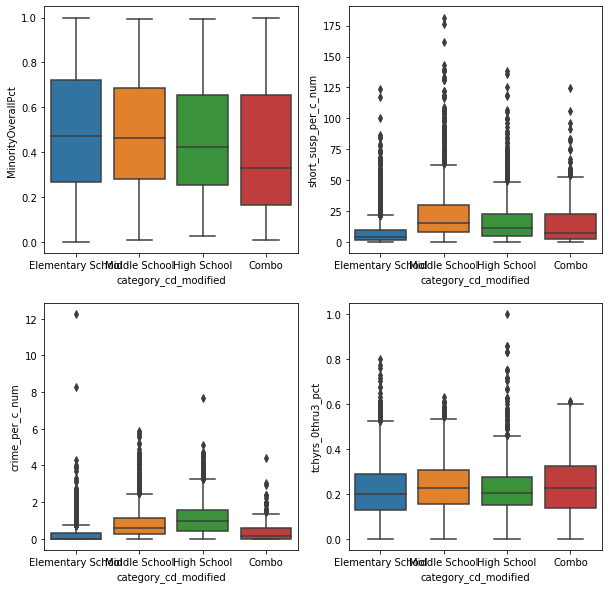

In [27]:
#Let's see the distribution of scores with different variables
f, axes = plt.subplots(2, 2,figsize=(10,10))
    
#SPG grade related to white percentage
sns.boxplot(  y="MinorityOverallPct", x= "category_cd_modified", data=schools2,
                orient='v' , ax=axes[0,0],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to Short term suspensions per 100 students
sns.boxplot(  y="short_susp_per_c_num", x= "category_cd_modified", data=schools2,
                orient='v' , ax=axes[0,1],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to Crime rate
sns.boxplot(  y="crime_per_c_num", x= "category_cd_modified", data=schools2,
                orient='v' , ax=axes[1,0],order=['Elementary School','Middle School','High School','Combo'])

#SPG grade related to teacher experience
sns.boxplot(  y="tchyrs_0thru3_pct", x= "category_cd_modified", data=schools2,
                orient='v' , ax=axes[1,1],order=['Elementary School','Middle School','High School','Combo'])

plt.show()

In [ ]:
To show distributions amongst different school types, we used box plots to graph against our continuous variables.

### Explore Attributes and Class
<!-- [10] Identify and explain interesting relationships between features and the class you are trying to predict (i.e., relationships with variables and the target classification). -->

With our response variable being SPG Score, here are some intresting relationships between our predictors and SPG Score.

Now let's do a univariate analysis on the impact of attendance rates on school performance grade. The expectation prior to doing the analysis is that poor attendance rates result in poor school performance.

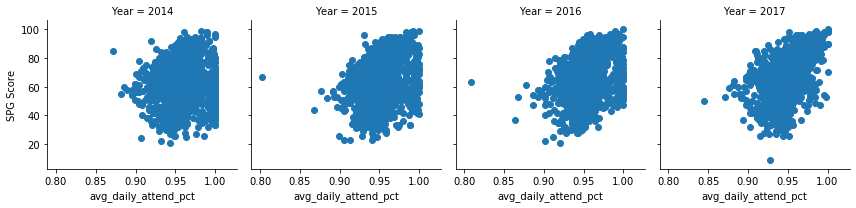

In [28]:
grid = sns.FacetGrid(SPG, col="Year")
grid.map(plt.scatter, 'avg_daily_attend_pct', 'SPG Score')

plt.show()

As expected, there is a positive correlation between the percentage of students regularly attending class and the overall quality of the school.

Some people theorize that smaller class sizes are associated with better student outcomes. Let's test that by looking at SPG score by number of students at a given school. 

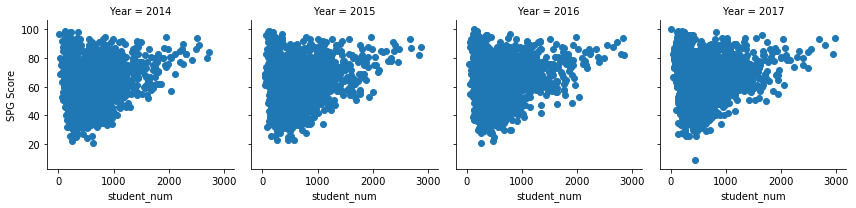

In [81]:
grid = sns.FacetGrid(SPG, col='Year')
grid.map(plt.scatter, 'student_num', 'SPG Score')
plt.show()

While this isn't a good measure of class size (we have no way of measuring student/teacher ratio. Just raw number of students), it's interesting to observe that larger public schools generally receive higher grades than smaller ones. It could be the case that here the size of the school is a stand-in for the rurality of the school. In rural areas, schools will be smaller, and there will be fewer opportunities for students. What happens when we color by the majority-minority variable? Of particular interest are high schools.

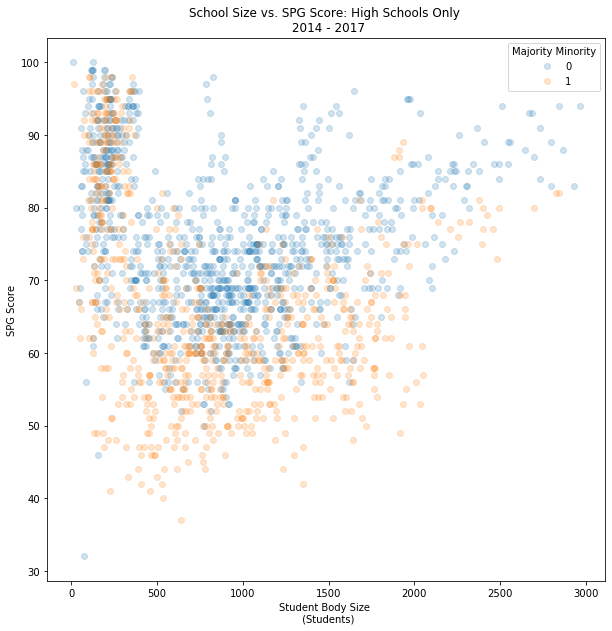

In [45]:
highschools = SPG[SPG['category_cd_modified'] == 'High School']

groups = highschools.groupby('Majority_Minority')

f, a = plt.subplots(figsize=(10,10))
for name, group in groups:
    plt.plot(group["student_num"], group["SPG Score"], marker="o", linestyle="",
             label=name, alpha=0.2)
    plt.xlabel("Student Body Size \n (Students)")
    plt.ylabel("SPG Score")
    plt.title("School Size vs. SPG Score: High Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")
plt.show()

High schools exhibit a particularly interesting trend. There seems to be some benefit to being either an exceptionally small or large high school, but being medium sized seems to be detrimental to the overall school quality. Not sure why this would be.

Now let's turn our attention to teacher hiring. It would be reasonable to hypothesize that having teachers with more experience would result in better educational quality. Let's test it.

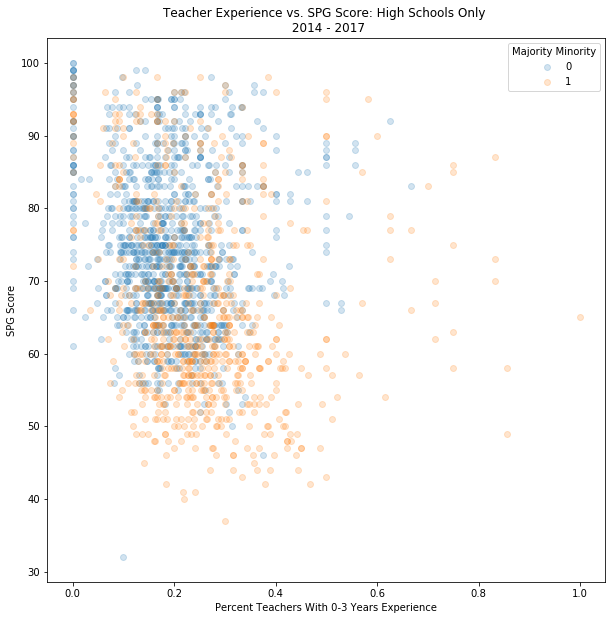

In [42]:
f, a = plt.subplots(figsize=(10,10))
for name, group in groups:
    plt.plot(group['tchyrs_0thru3_pct'], group['SPG Score'], marker = "o", linestyle="",
             label=name, alpha=0.2)
    plt.xlabel("Percent Teachers With 0-3 Years Experience")
    plt.ylabel("SPG Score")
    plt.title("Teacher Experience vs. SPG Score: High Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")
plt.show()

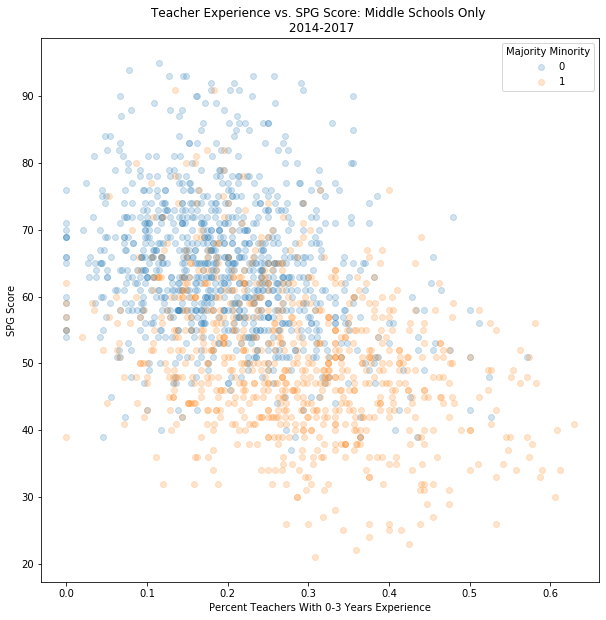

In [41]:
middleschools = SPG[SPG['category_cd_modified'] == 'Middle School']
groups_m = middleschools.groupby('Majority_Minority')

f, a = plt.subplots(figsize=(10,10))
for name, group in groups_m:
    plt.plot(group['tchyrs_0thru3_pct'], group['SPG Score'], marker = "o", linestyle="",
             label=name, alpha=0.2)
    plt.xlabel("Percent Teachers With 0-3 Years Experience")
    plt.ylabel("SPG Score")
    plt.title("Teacher Experience vs. SPG Score: Middle Schools Only \n 2014-2017")
    plt.legend(title="Majority Minority")
plt.show()

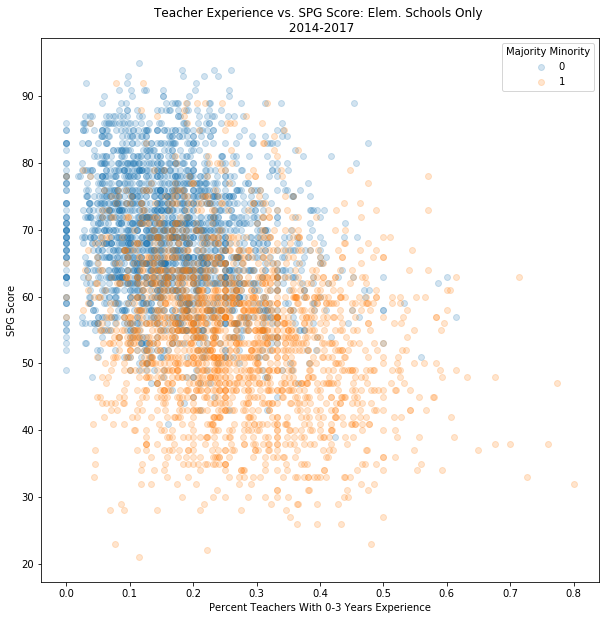

In [40]:
elemschools = SPG[SPG['category_cd_modified'] == 'Elementary School']
groups_e = elemschools.groupby('Majority_Minority')

f, a = plt.subplots(figsize=(10,10))
for name, group in groups_e:
    plt.plot(group['tchyrs_0thru3_pct'], group['SPG Score'], marker = "o", linestyle="",
             label=name, alpha=0.2)
    plt.xlabel("Percent Teachers With 0-3 Years Experience")
    plt.ylabel("SPG Score")
    plt.title("Teacher Experience vs. SPG Score: Elem. Schools Only \n 2014-2017")
    plt.legend(title="Majority Minority")
plt.show()

It appears that there isn't much of an effect of inexperienced teachers on older students, but there seems to be a very detrimental effect for middle and elementary schools. The detrimental effect is particularly strong for schools with large percentages of minority students. 

Does disciplinary policy effect school quality? Let's take a look at suspensions. 

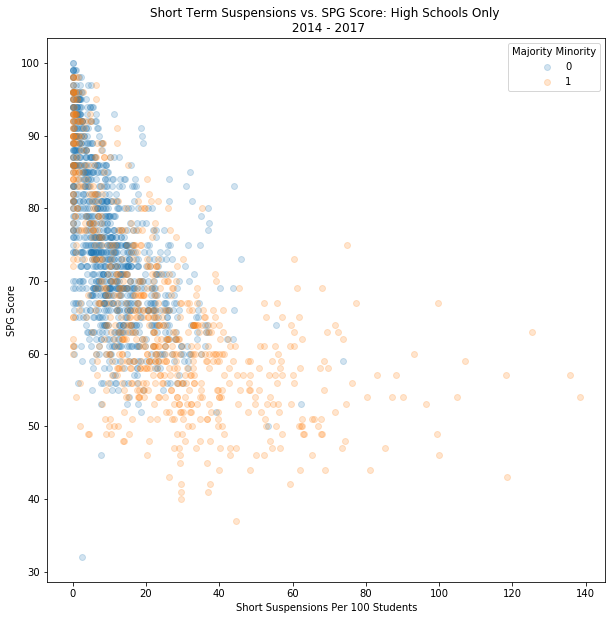

In [38]:
f, a = plt.subplots(figsize=(10,10))
for name, group in groups:
    plt.plot(group['short_susp_per_c_num'], group['SPG Score'], marker = "o", linestyle="",
             label=name, alpha=0.2)
    plt.xlabel("Short Suspensions Per 100 Students")
    plt.ylabel("SPG Score")
    plt.title("Short Term Suspensions vs. SPG Score: High Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")
plt.show()

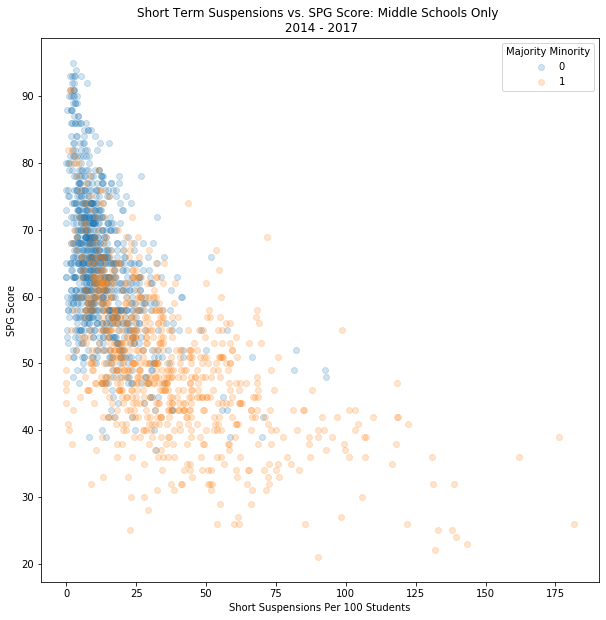

In [37]:
f, a = plt.subplots(figsize=(10,10))
for name, group in groups_m:
    plt.plot(group['short_susp_per_c_num'], group['SPG Score'], marker = "o",
             linestyle="", label=name, alpha=0.2)
    plt.xlabel("Short Suspensions Per 100 Students")
    plt.ylabel("SPG Score")
    plt.title("Short Term Suspensions vs. SPG Score: Middle Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")
plt.show()

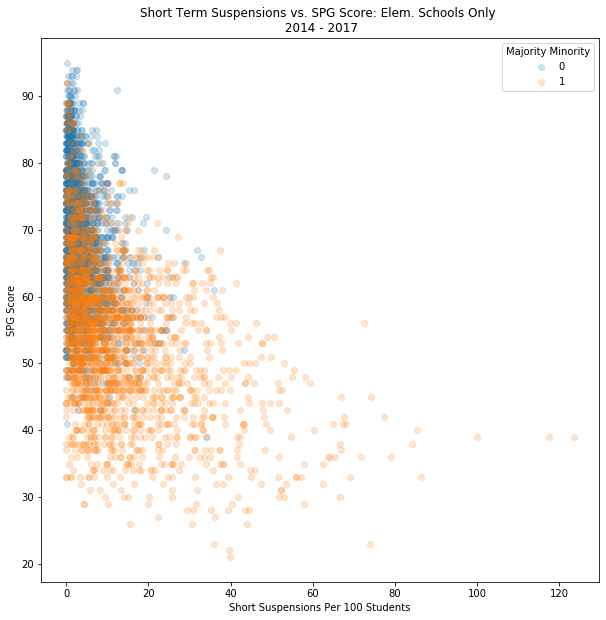

In [36]:
f, a = plt.subplots(figsize=(10,10))
for name, group in groups_e:
    plt.plot(group['short_susp_per_c_num'], group['SPG Score'], marker = "o", linestyle="",
             label=name, alpha=0.2)
    plt.xlabel("Short Suspensions Per 100 Students")
    plt.ylabel("SPG Score")
    plt.title("Short Term Suspensions vs. SPG Score: Elem. Schools Only \n 2014 - 2017")
    plt.legend(title="Majority Minority")
    
plt.show()

Across the board, short-term suspensions seem to negatively effect the overall quality of a school. With that said, we should be careful not to conflate correlation and causation here. While it may seem that high numbers of short-term suspensions are causing the schools to be rated poorly, it is also possible that high numbers of short-term suspensions are related to high crime rates, and schools with high crime rates are generally not ranked well.

### New Features
<!-- [5] Are there other features that could be added to the data or created from existing features? Which ones? -->

In total, there 259 attributes in the dataset, giving us a wide variety of new features we could potentially calculate. The Majority_Minority variable is one such calculation. Furthermore, our reclassification of combination schools is another example of a feature engineered with modeling in mind.

We can bring outside data as well, for example the GSS (General Social Survey) or the Census dataset, attributes such as income percentage, tax brackets, and other demographics. With these features we can run additional assumptions on how these attributes may contribute to students and their scores.

### Exceptional Work
#### Regression

In [36]:
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder 
from sklearn import metrics

# creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')

# passing category_cd_modified
enc_df = pd.DataFrame(enc.fit_transform(schools2[['category_cd_modified']]).toarray())

#Creating working dataframe for regression
X = schools2[['Majority_Minority', 'avg_daily_attend_pct', 'student_num', 'tchyrs_0thru3_pct',
              'short_susp_per_c_num']]

X = pd.concat([X.reset_index(drop=True), enc_df], axis=1)

y = schools2['SPG Score']

#Split into train/test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

#Train model on training set
regressor = LinearRegression()  
regressor.fit(X_train, y_train)

y_pred = regressor.predict(X_test)

df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})

print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Root Mean Squared Error: 11.002376519436433


On average the model misses the SPG Score by 11 grade points. While this is not necessarily a bad model, it's certainly not something ready to be used in practice for prediction purposes. After all, a difference in 11 points is a difference in letter grade. Perhaps more careful consideration of features and model interactions is needed. Alternatively, more advanced modeling strategies might yield more accurate results. 

With that said, the regression model is useful for inference on the data. Reading off the model coefficients, we can now say with confidence that high rates of suspensions and inexperienced teachers are detrimental to school quality, particularly for schools with high minority populations. Furthermore, low rates of attendance are also detrimental.

Some of these conclusions are directly actionable for the Belk Endowment. Based on the results of this analysis, the foundation should focus on initiatives that promote increased attendance and the hiring of experienced teachers in schools that are performing poorly.

#### Year over Year Trends
Because we combined the data provided, we were able to create trend lines between 2014 and 2017. First, we'll look at the trend of SPG score over these years.

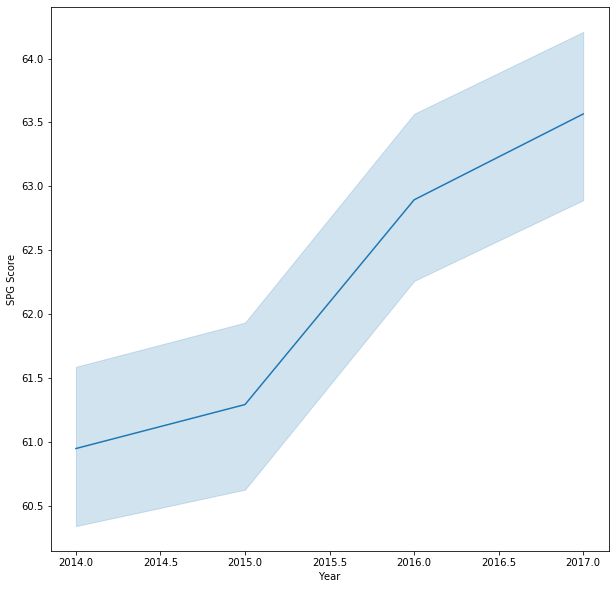

In [37]:
f, a = plt.subplots(figsize=(10,10))
sns.lineplot(x="Year", y="SPG Score", data=schools2)
plt.show()

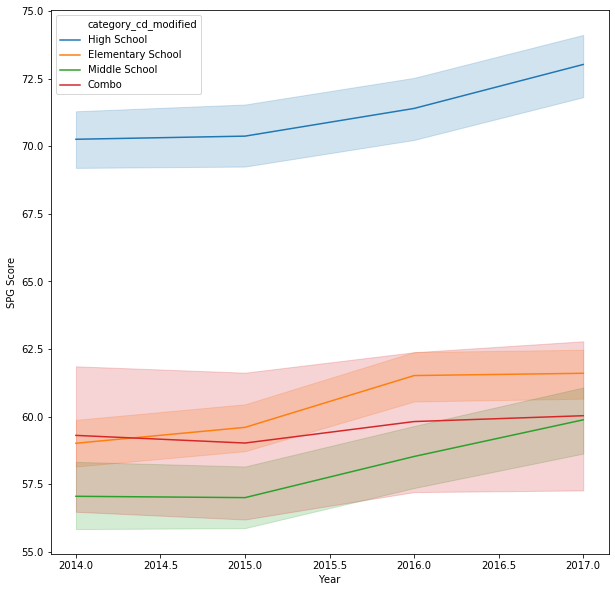

In [38]:
# trendline by category
f, a = plt.subplots(figsize=(10,10))
sns.lineplot(x="Year", y="SPG Score", hue="category_cd_modified", data=schools2)
plt.show()

To end this analysis on a positive note, things seem to be getting better over time for North Carolina Public Schools. While there are certainly still gaps in educational achievement, there is evidence to show that striving to provide a better future for young people is a worthwhile pursuit with tangible results. It is the hope of the authors of this analysis that our results can serve as a meaningful contribution to this pursuit.